In [1]:
import pandas as pd
import numpy as np
import os

import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import seaborn as sns
import plotly.express as px # Plotly express!
import plotly.graph_objects as go # Plotly graph objects!
from plotly.subplots import make_subplots

import statsmodels.api as sm
import statsmodels.formula.api as smf

# scikit-learn: barebones, but fast and reliable
from sklearn.linear_model import LogisticRegression, LinearRegression

# statsmodels: pretty and good to use, great for interpretable ML
from statsmodels.formula.api import ols, logit
from statsmodels.stats.anova import anova_lm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.graphics.regressionplots import plot_partregress_grid, influence_plot

/opt/conda/lib/python3.9/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.26.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
dat = pd.read_csv('medicalmalpractice.csv')

# Amount

## Histogram of claim amounts

In [3]:
g = px.histogram(data_frame = dat, x = 'Amount', nbins = 20, marginal = "box")
g.show()

## Claim amounts, color by severity

### This is going to look horrible until we use the zoom function.

In [4]:
g = px.histogram(data_frame = dat, x = 'Amount', nbins = 20, color="Severity", marginal="box")
g.show()

# Age

In [5]:
g = px.histogram(data_frame = dat, x = 'Age', nbins = 20)
g.show()

## Patient age & amount of claim

In [6]:
fig = px.scatter(dat, x="Age", y="Amount")
fig.show()

## Patient age & severity of claim

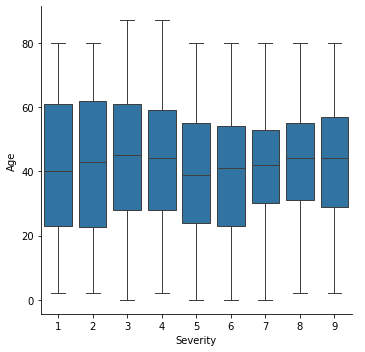

In [7]:
sns.catplot(x = 'Severity',
            y = 'Age',
            data = dat, 
            kind = 'box')
plt.show()

Bar lengths and mean are consistent across different severity. Visually, age doesn't appear to have an effect on severity.

# Patient gender

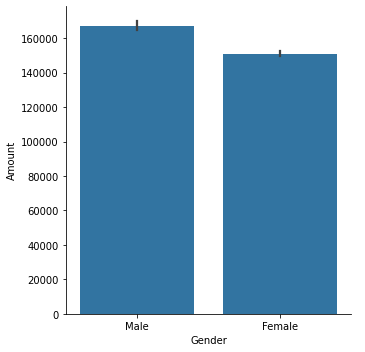

In [8]:
sns.catplot(data = dat,
            x = 'Gender', 
            y = 'Amount',
            kind = 'bar')
plt.show()

In [9]:
print("The average claim amount for a male patient is {}.".format(float(dat.query('`Gender` == "Male"')['Amount'].mean())))

The average claim amount for a male patient is 167401.30677480917.


In [10]:
print("The average claim amount for a female patient is {}.".format(float(dat.query('`Gender` == "Female"')['Amount'].mean())))

The average claim amount for a female patient is 150957.80828972158.


# Claimant marital status

In [11]:
g = px.histogram(data_frame = dat, x = 'Marital Status', nbins = 5)
g.show()

## Claimant marital status & claim amount

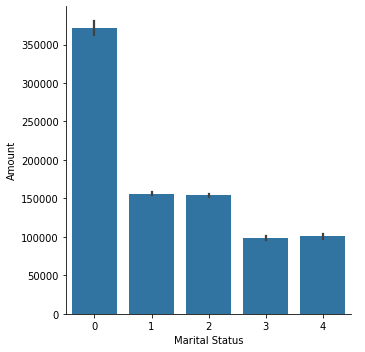

In [12]:
sns.catplot(data = dat,
            x = 'Marital Status', 
            y = 'Amount',
            kind = 'bar')
plt.show()

## Claimant marital status & severity

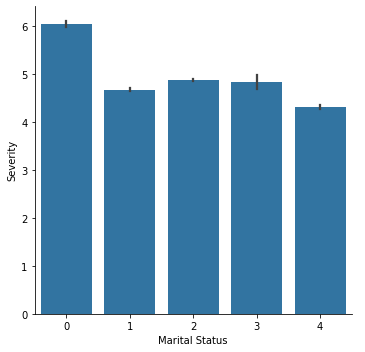

In [13]:
sns.catplot(data = dat,
            x = 'Marital Status', 
            y = 'Severity',
            kind = 'bar')
plt.show()

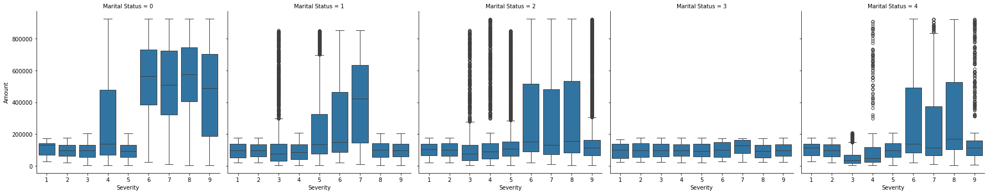

In [14]:
sns.catplot(data = dat,
            x = 'Severity',
            y = 'Amount',
            kind = 'box',
           col = "Marital Status")
plt.show()

# Private attorney

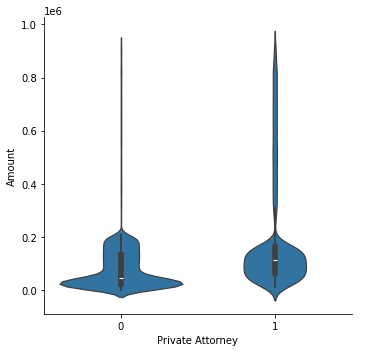

In [15]:
sns.catplot(x = 'Private Attorney', 
            y = 'Amount', 
            data = dat, 
            kind = 'violin')
plt.show()

# Patient insurance type

In [16]:
g = px.histogram(data_frame = dat, x = 'Insurance', nbins = 5)
g.show()

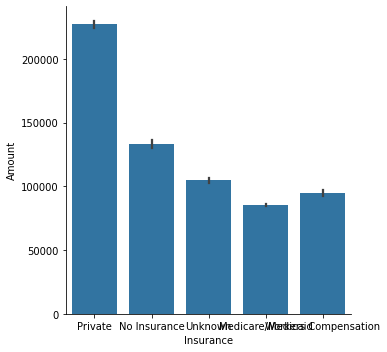

In [17]:
sns.catplot(data = dat,
            x = 'Insurance', 
            y = 'Amount',
            kind = 'bar')
plt.show()

# Doctor's specialty

## Specialty counts

In [18]:
g = px.histogram(data_frame = dat, x = 'Specialty', nbins = 20)
g.show()

## Specialty & severity

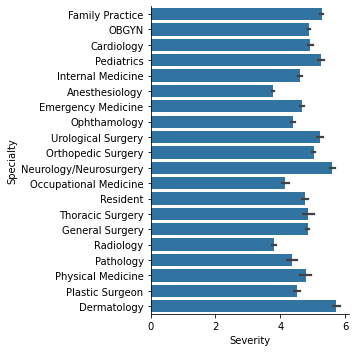

In [19]:
sns.catplot(data = dat,
            x = 'Severity', 
            y = 'Specialty',
            ##order = dat.sort_values('Severity').Specialty,
            kind = 'bar')
plt.show()

## Specialty & amount

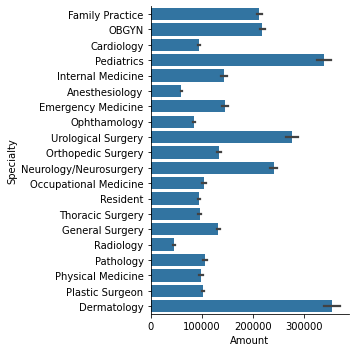

In [20]:
sns.catplot(data = dat,
            x = 'Amount',
            y = 'Specialty',  
            ##order = dat.sort_values('Amount').Specialty,
            kind = 'bar')
plt.show()

# Regressions

## Amount ~ Severity

In [21]:
# Create the model.Fit the model
## just severity for comparison
## Log amount to read as percentage
model = ols('I(np.log(Amount)) ~ Severity', data = dat).fit()

# Print the parameters
print(model.params)
model.summary()

Intercept    10.546054
Severity      0.176313
dtype: float64


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:      I(np.log(Amount))   R-squared:                       0.110
Model:                            OLS   Adj. R-squared:                  0.110
Method:                 Least Squares   F-statistic:                     9819.
Date:                Fri, 06 Sep 2024   Prob (F-statistic):               0.00
Time:                        15:42:54   Log-Likelihood:            -1.1575e+05
No. Observations:               79210   AIC:                         2.315e+05
Df Residuals:                   79208   BIC:                         2.315e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     10.5461      0.009   1132.764      0.000      10.528      10.564
Severity       0.1763      0.002     99.090      0.000       0.173       0.180
==============================================================================
Omnibus:                     1545.788   Durbin-Watson:                   2.004
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1655.096
Skew:                          -0.335   Prob(JB):                         0.00
Kurtosis:                       3.230   Cond. No.                         13.5
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [22]:
print("Model with only severity:\n")
mse = model.mse_resid
print('The mean squared error: ' + str(mse))

# Residual Standard Error
rse = np.sqrt(mse)
print('The Residual Standard Error: ' + str(rse))

# R-squared
rsq = model.rsquared
print('R-squared: ' + str(rsq))

Model with only severity:

The mean squared error: 1.0885407810733652
The Residual Standard Error: 1.0433315777227128
R-squared: 0.11029099098477702


## Every single variable.

In [23]:
# Create the model.Fit the model
model_all = ols('I(np.log(Amount)) ~ Specialty+Severity+Age+Q("Private Attorney")+Q("Marital Status")+Insurance+Gender', data = dat).fit()

# Print the parameters
print(model_all.summary())

                            OLS Regression Results                            
Dep. Variable:      I(np.log(Amount))   R-squared:                       0.342
Model:                            OLS   Adj. R-squared:                  0.342
Method:                 Least Squares   F-statistic:                     1470.
Date:                Fri, 06 Sep 2024   Prob (F-statistic):               0.00
Time:                        15:42:56   Log-Likelihood:            -1.0380e+05
No. Observations:               79210   AIC:                         2.077e+05
Df Residuals:                   79181   BIC:                         2.079e+05
Df Model:                          28                                         
Covariance Type:            nonrobust                                         
                                          coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
In

In [24]:
print("Model with all variables:\n")
mse_all = model_all.mse_resid
print('The mean squared error: ' + str(mse_all))

# Residual Standard Error
rse_all = np.sqrt(mse_all)
print('The Residual Standard Error: ' + str(rse_all))

# R-squared
rsq_all = model_all.rsquared
print('R-squared: ' + str(rsq_all))

Model with all variables:

The mean squared error: 0.8053145108949293
The Residual Standard Error: 0.8973931751996609
R-squared: 0.3420078028288477


In [25]:
model_all.params

Intercept                              10.306868
Specialty[T.Cardiology]                -0.023670
Specialty[T.Dermatology]                1.139363
Specialty[T.Emergency Medicine]         0.234724
Specialty[T.Family Practice]            0.428857
Specialty[T.General Surgery]            0.247112
Specialty[T.Internal Medicine]          0.279693
Specialty[T.Neurology/Neurosurgery]     0.499727
Specialty[T.OBGYN]                      0.579870
Specialty[T.Occupational Medicine]      0.621544
Specialty[T.Ophthamology]               0.067925
Specialty[T.Orthopedic Surgery]         0.133079
Specialty[T.Pathology]                  0.590413
Specialty[T.Pediatrics]                 0.765985
Specialty[T.Physical Medicine]          0.000615
Specialty[T.Plastic Surgeon]            0.306105
Specialty[T.Radiology]                 -0.193971
Specialty[T.Resident]                   0.172821
Specialty[T.Thoracic Surgery]          -0.045758
Specialty[T.Urological Surgery]         0.987586
Insurance[T.No Insur

# Coefficient plot - All variables

In [26]:
## Code for coefplot in python from:
## https://zhiyzuo.github.io/Python-Plot-Regression-Coefficient/

model_all.conf_int()
err_series = model_all.params - model_all.conf_int()[0]
coef_df = pd.DataFrame({'coef': model_all.params.values[1:],
                        'err': err_series.values[1:],
                        'varname': err_series.index.values[1:]
                       })
coef_df

,coef,err,varname
0,-0.023670,0.041594,Specialty[T.Cardiology]
1,1.139363,0.051563,Specialty[T.Dermatology]
2,0.234724,0.032686,Specialty[T.Emergency Medicine]
3,0.428857,0.028180,Specialty[T.Family Practice]
4,0.247112,0.028380,Specialty[T.General Surgery]
5,0.279693,0.031355,Specialty[T.Internal Medicine]
6,0.499727,0.034569,Specialty[T.Neurology/Neurosurgery]
7,0.579870,0.029013,Specialty[T.OBGYN]
8,0.621544,0.068592,Specialty[T.Occupational Medicine]
9,0.067925,0.037026,Specialty[T.Ophthamology]


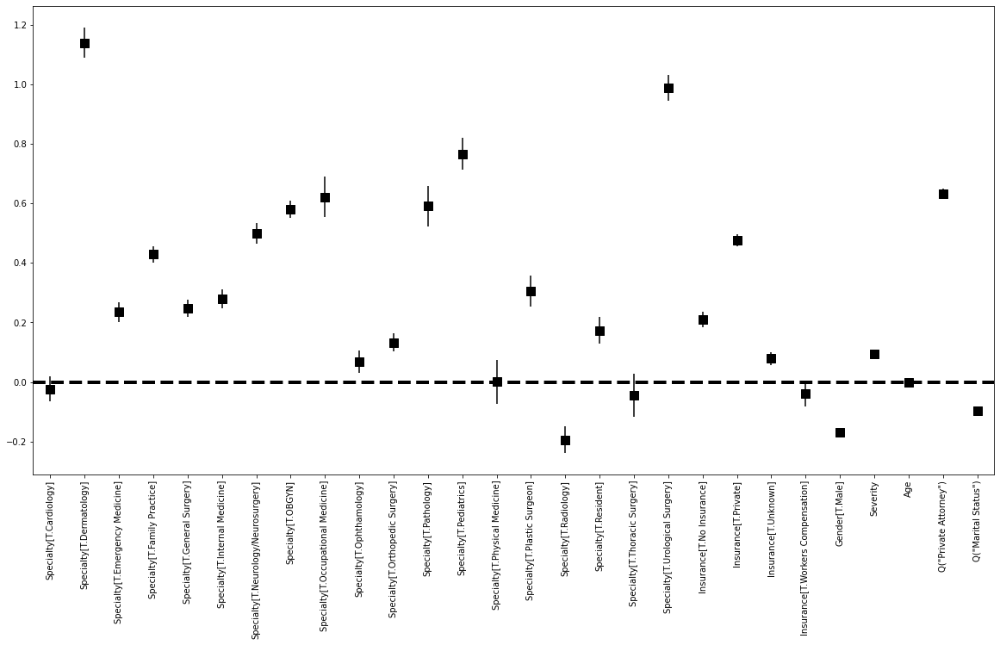

In [27]:
fig, ax = plt.subplots(figsize=(20, 10))
coef_df.plot(x='varname', y='coef', kind='bar', 
             ax=ax, color='none', 
             yerr='err', legend=False)
ax.set_ylabel('')
ax.set_xlabel('')
ax.scatter(x=np.arange(coef_df.shape[0]), 
           marker='s', s=120, 
           y=coef_df['coef'], color='black')
ax.axhline(y=0, linestyle='--', color='black', linewidth=4)
##ax.xaxis.set_ticks_position('none')

# Coefficient plot - specialties only

In [28]:
model_all.conf_int()
sp_err_series = model_all.params - model_all.conf_int()[0]
spcoef_df = pd.DataFrame({'coef': model_all.params.values[1:20],
                        'err': err_series.values[1:20],
                        'varname': err_series.index.values[1:20]
                       })
spcoef_df

,coef,err,varname
0,-0.023670,0.041594,Specialty[T.Cardiology]
1,1.139363,0.051563,Specialty[T.Dermatology]
2,0.234724,0.032686,Specialty[T.Emergency Medicine]
3,0.428857,0.028180,Specialty[T.Family Practice]
4,0.247112,0.028380,Specialty[T.General Surgery]
5,0.279693,0.031355,Specialty[T.Internal Medicine]
6,0.499727,0.034569,Specialty[T.Neurology/Neurosurgery]
7,0.579870,0.029013,Specialty[T.OBGYN]
8,0.621544,0.068592,Specialty[T.Occupational Medicine]
9,0.067925,0.037026,Specialty[T.Ophthamology]


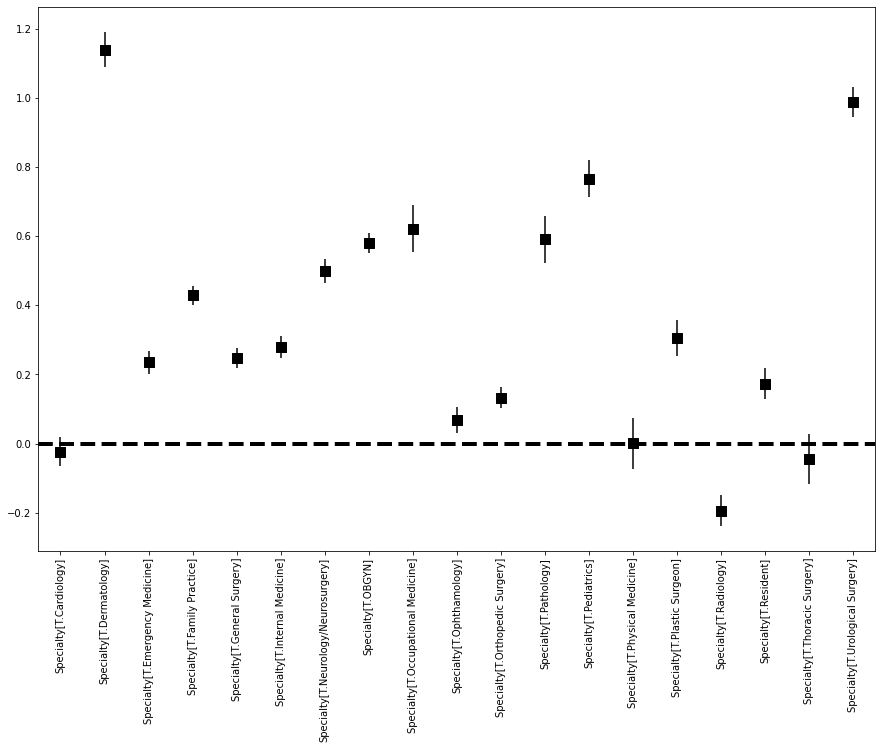

In [29]:
fig, ax = plt.subplots(figsize=(15, 10))
spcoef_df.plot(x='varname', y='coef', kind='bar', 
             ax=ax, color='none', 
             yerr='err', legend=False)
ax.set_ylabel('')
ax.set_xlabel('')
ax.scatter(x=np.arange(spcoef_df.shape[0]), 
           marker='s', s=120, 
           y=spcoef_df['coef'], color='black')
ax.axhline(y=0, linestyle='--', color='black', linewidth=4)
##ax.xaxis.set_ticks_position('none')

# Coefficient plot: Insurance only

In [30]:
model_all.conf_int()
in_err_series = model_all.params - model_all.conf_int()[0]
incoef_df = pd.DataFrame({'coef': model_all.params.values[20:24],
                        'err': err_series.values[20:24],
                        'varname': err_series.index.values[20:24]
                       })
incoef_df

,coef,err,varname
0,0.210736,0.026041,Insurance[T.No Insurance]
1,0.475198,0.019723,Insurance[T.Private]
2,0.078417,0.021085,Insurance[T.Unknown]
3,-0.039652,0.043262,Insurance[T.Workers Compensation]


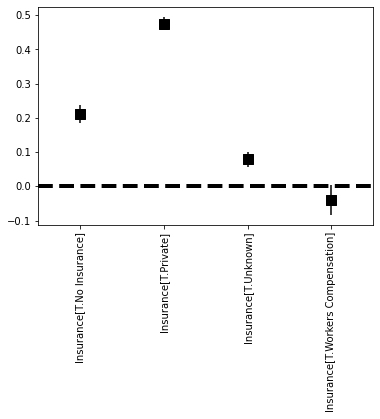

In [31]:
fig, ax = plt.subplots()
incoef_df.plot(x='varname', y='coef', kind='bar', 
             ax=ax, color='none', 
             yerr='err', legend=False)
ax.set_ylabel('')
ax.set_xlabel('')
ax.scatter(x=np.arange(incoef_df.shape[0]), 
           marker='s', s=120, 
           y=incoef_df['coef'], color='black')
ax.axhline(y=0, linestyle='--', color='black', linewidth=4)
##ax.xaxis.set_ticks_position('none')

# Coefficient plot: Other variables

In [32]:
model_all.conf_int()
ot_err_series = model_all.params - model_all.conf_int()[0]
otcoef_df = pd.DataFrame({'coef': model_all.params.values[24:],
                        'err': err_series.values[24:],
                        'varname': err_series.index.values[24:]
                       })
otcoef_df

,coef,err,varname
0,-0.169017,0.015836,Gender[T.Male]
1,0.094438,0.003204,Severity
2,-0.002138,0.000333,Age
3,0.632351,0.016995,"Q(""Private Attorney"")"
4,-0.097435,0.006586,"Q(""Marital Status"")"


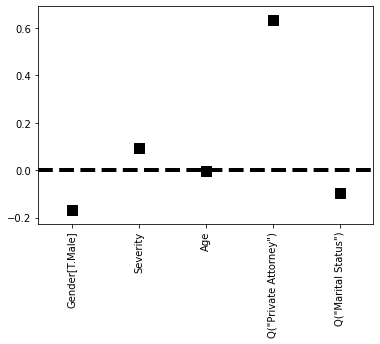

In [33]:
fig, ax = plt.subplots()
otcoef_df.plot(x='varname', y='coef', kind='bar', 
             ax=ax, color='none', 
             yerr='err', legend=False)
ax.set_ylabel('')
ax.set_xlabel('')
ax.scatter(x=np.arange(otcoef_df.shape[0]), 
           marker='s', s=120, 
           y=otcoef_df['coef'], color='black')
ax.axhline(y=0, linestyle='--', color='black', linewidth=4)
##ax.xaxis.set_ticks_position('none')